### Importo le librerie 

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt 
import seaborn as sns
import plotly
import plotly.express as px

# Lettura e comprensione del dataset

In [2]:
airbnb = pd.read_csv('../dataset/Originali/Airbnb_Open_Data.csv')
airbnb.head()

C:\Users\franc\AppData\Local\Temp\ipykernel_23728\1330424972.py:1: DtypeWarning: Columns (25) have mixed types. Specify dtype option on import or set low_memory=False.
  airbnb = pd.read_csv('../dataset/Originali/Airbnb_Open_Data.csv')


,id,NAME,host id,host_identity_verified,host name,neighbourhood group,neighbourhood,lat,long,country,...,service fee,minimum nights,number of reviews,last review,reviews per month,review rate number,calculated host listings count,availability 365,house_rules,license
0,1001254,Clean & quiet apt home by the park,80014485718,unconfirmed,Madaline,Brooklyn,Kensington,40.64749,-73.97237,United States,...,$193,10.0,9.0,10/19/2021,0.21,4.0,6.0,286.0,Clean up and treat the home the way you'd like...,NaN
1,1002102,Skylit Midtown Castle,52335172823,verified,Jenna,Manhattan,Midtown,40.75362,-73.98377,United States,...,$28,30.0,45.0,5/21/2022,0.38,4.0,2.0,228.0,Pet friendly but please confirm with me if the...,NaN
2,1002403,THE VILLAGE OF HARLEM....NEW YORK !,78829239556,NaN,Elise,Manhattan,Harlem,40.80902,-73.94190,United States,...,$124,3.0,0.0,NaN,NaN,5.0,1.0,352.0,"I encourage you to use my kitchen, cooking and...",NaN
3,1002755,NaN,85098326012,unconfirmed,Garry,Brooklyn,Clinton Hill,40.68514,-73.95976,United States,...,$74,30.0,270.0,7/5/2019,4.64,4.0,1.0,322.0,NaN,NaN
4,1003689,Entire Apt: Spacious Studio/Loft by central park,92037596077,verified,Lyndon,Manhattan,East Harlem,40.79851,-73.94399,United States,...,$41,10.0,9.0,11/19/2018,0.10,3.0,1.0,289.0,"Please no smoking in the house, porch or on th...",NaN


In [3]:
airbnb.shape

(102599, 26)

In [4]:
airbnb.describe()

,id,host id,lat,long,Construction year,minimum nights,number of reviews,reviews per month,review rate number,calculated host listings count,availability 365
count,1.025990e+05,1.025990e+05,102591.000000,102591.000000,102385.000000,102190.000000,102416.000000,86720.000000,102273.000000,102280.000000,102151.000000
mean,2.914623e+07,4.925411e+10,40.728094,-73.949644,2012.487464,8.135845,27.483743,1.374022,3.279106,7.936605,141.133254
std,1.625751e+07,2.853900e+10,0.055857,0.049521,5.765556,30.553781,49.508954,1.746621,1.284657,32.218780,135.435024
min,1.001254e+06,1.236005e+08,40.499790,-74.249840,2003.000000,-1223.000000,0.000000,0.010000,1.000000,1.000000,-10.000000
25%,1.508581e+07,2.458333e+10,40.688740,-73.982580,2007.000000,2.000000,1.000000,0.220000,2.000000,1.000000,3.000000
50%,2.913660e+07,4.911774e+10,40.722290,-73.954440,2012.000000,3.000000,7.000000,0.740000,3.000000,1.000000,96.000000
75%,4.320120e+07,7.399650e+10,40.762760,-73.932350,2017.000000,5.000000,30.000000,2.000000,4.000000,2.000000,269.000000
max,5.736742e+07,9.876313e+10,40.916970,-73.705220,2022.000000,5645.000000,1024.000000,90.000000,5.000000,332.000000,3677.000000


In [5]:
airbnb.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 102599 entries, 0 to 102598
Data columns (total 26 columns):
 #   Column                          Non-Null Count   Dtype  
---  ------                          --------------   -----  
 0   id                              102599 non-null  int64  
 1   NAME                            102349 non-null  object 
 2   host id                         102599 non-null  int64  
 3   host_identity_verified          102310 non-null  object 
 4   host name                       102193 non-null  object 
 5   neighbourhood group             102570 non-null  object 
 6   neighbourhood                   102583 non-null  object 
 7   lat                             102591 non-null  float64
 8   long                            102591 non-null  float64
 9   country                         102067 non-null  object 
 10  country code                    102468 non-null  object 
 11  instant_bookable                102494 non-null  object 
 12  cancellation_pol

# Pre-Processing

Elimino le colonne che so a priori non essere rilevanti

In [6]:
columns_to_drop = ['country', 'country code', 'NAME', 'license','host name', 'house_rules']
airbnb = airbnb.drop(columns=columns_to_drop, errors='ignore')
airbnb.head()

,id,host id,host_identity_verified,neighbourhood group,neighbourhood,lat,long,instant_bookable,cancellation_policy,room type,Construction year,price,service fee,minimum nights,number of reviews,last review,reviews per month,review rate number,calculated host listings count,availability 365
0,1001254,80014485718,unconfirmed,Brooklyn,Kensington,40.64749,-73.97237,False,strict,Private room,2020.0,$966,$193,10.0,9.0,10/19/2021,0.21,4.0,6.0,286.0
1,1002102,52335172823,verified,Manhattan,Midtown,40.75362,-73.98377,False,moderate,Entire home/apt,2007.0,$142,$28,30.0,45.0,5/21/2022,0.38,4.0,2.0,228.0
2,1002403,78829239556,NaN,Manhattan,Harlem,40.80902,-73.94190,True,flexible,Private room,2005.0,$620,$124,3.0,0.0,NaN,NaN,5.0,1.0,352.0
3,1002755,85098326012,unconfirmed,Brooklyn,Clinton Hill,40.68514,-73.95976,True,moderate,Entire home/apt,2005.0,$368,$74,30.0,270.0,7/5/2019,4.64,4.0,1.0,322.0
4,1003689,92037596077,verified,Manhattan,East Harlem,40.79851,-73.94399,False,moderate,Entire home/apt,2009.0,$204,$41,10.0,9.0,11/19/2018,0.10,3.0,1.0,289.0


Elimino le colonne duplicate

In [7]:
airbnb.drop_duplicates(inplace=True)

Rimuovo il simbolo '$' dalle colonne 'service fee' e 'price' e le converto in interi

In [8]:
airbnb['price'] = airbnb['price'].replace('[\$,]', '', regex=True)
airbnb['service fee'] = airbnb['service fee'].replace('[\$,]', '', regex=True)
airbnb['price'] = airbnb['price'].astype(str)
airbnb['service fee'] = airbnb['service fee'].astype(str)
airbnb['price'] = airbnb['price'].str.strip()
airbnb['service fee'] = airbnb['service fee'].str.strip()
airbnb = airbnb[pd.to_numeric(airbnb['price'], errors='coerce').notnull()]
airbnb['price'] = pd.to_numeric(airbnb['price'])
airbnb = airbnb[pd.to_numeric(airbnb['service fee'], errors='coerce').notnull()]
airbnb['service fee'] = pd.to_numeric(airbnb['service fee'])
airbnb[['price', 'service fee']].head()

,price,service fee
0,966,193
1,142,28
2,620,124
3,368,74
4,204,41


Converto la colonna room type da tipo object a tipo stringa 

In [9]:
airbnb['room type'] = airbnb['room type'].astype(str)
airbnb[['room type']].head()

,room type
0,Private room
1,Entire home/apt
2,Private room
3,Entire home/apt
4,Entire home/apt


Converto la colonna 'last review' da Object a data

In [10]:
airbnb['last review'] = pd.to_datetime(airbnb['last review'])

In [11]:
airbnb['availability 365'].describe()

count    101124.000000
mean        141.033642
std         135.410940
min         -10.000000
25%           3.000000
50%          96.000000
75%         268.000000
max        3677.000000
Name: availability 365, dtype: float64

Se availability 365 è negativo converto il suo valore in positivo, se è maggiore di 365 lo pongo a 365

In [12]:
airbnb['availability 365'] = np.where(airbnb['availability 365']<0, airbnb['availability 365']*-1, airbnb['availability 365'])
airbnb['availability 365'] = np.where(airbnb['availability 365']>365, 365, airbnb['availability 365'])

In [13]:
airbnb['minimum nights'].describe()

count    101172.000000
mean          8.103892
std          30.620932
min       -1223.000000
25%           2.000000
50%           3.000000
75%           5.000000
max        5645.000000
Name: minimum nights, dtype: float64

In [14]:
airbnb['minimum nights'] = np.where(airbnb['minimum nights']<0, airbnb['minimum nights']*-1, airbnb['minimum nights'])
airbnb['minimum nights'] = np.where(airbnb['minimum nights']>365, 365, airbnb['minimum nights'])
airbnb['minimum nights'] = airbnb['minimum nights'].fillna(1)

Controllo i valori unici di neighbourhood group

In [15]:
unique_neighbourhood_groups = airbnb['neighbourhood group'].unique()
print(unique_neighbourhood_groups)

['Brooklyn' 'Manhattan' 'brookln' 'Queens' nan 'Staten Island' 'Bronx']


In [16]:
airbnb['neighbourhood group'] = airbnb['neighbourhood group'].replace('brookln', 'Brooklyn')

Controllo quanti valori null ci sono per ogni colonna

In [17]:
airbnb.isnull().sum()

id                                    0
host id                               0
host_identity_verified              284
neighbourhood group                  28
neighbourhood                        15
lat                                   8
long                                  8
instant_bookable                     96
cancellation_policy                  71
room type                             0
Construction year                   204
price                                 0
service fee                           0
minimum nights                        0
number of reviews                   183
last review                       15782
reviews per month                 15767
review rate number                  319
calculated host listings count      319
availability 365                    448
dtype: int64

## Mi occupo della gestione delle celle null per ogni colonna

In [18]:
airbnb['host_identity_verified'] = airbnb['host_identity_verified'].fillna('unconfirmed')
airbnb['calculated host listings count'] = airbnb.groupby('host id')['calculated host listings count'].transform(lambda x: x.fillna(x.count()))

Droppo le righe che hanno le seguenti colonne null, in quanto la moda non è affidabile in questo caso

In [19]:
airbnb = airbnb.dropna(subset=['neighbourhood group','neighbourhood'])
airbnb = airbnb.dropna(subset=['lat','long'])
airbnb = airbnb.dropna(subset=['instant_bookable'])

Sostituisco i valori null di 'cancellation_policy' con la moda 

In [20]:
modal_value = airbnb['cancellation_policy'].mode()[0]
airbnb['cancellation_policy'].fillna(modal_value, inplace=True)

Sostituisco i valori null di 'Construction year' con la media del quartiere corrispondente

In [21]:
construction_year_mean = airbnb.groupby('neighbourhood group')['Construction year'].mean()
airbnb['Construction year'] = airbnb.apply(lambda row: construction_year_mean[row['neighbourhood group']] 
                                  if pd.isnull(row['Construction year']) 
                                  else row['Construction year'], axis=1)
airbnb['Construction year'] = airbnb['Construction year'].astype(int)

Verifico la distribuzione di number of reviews

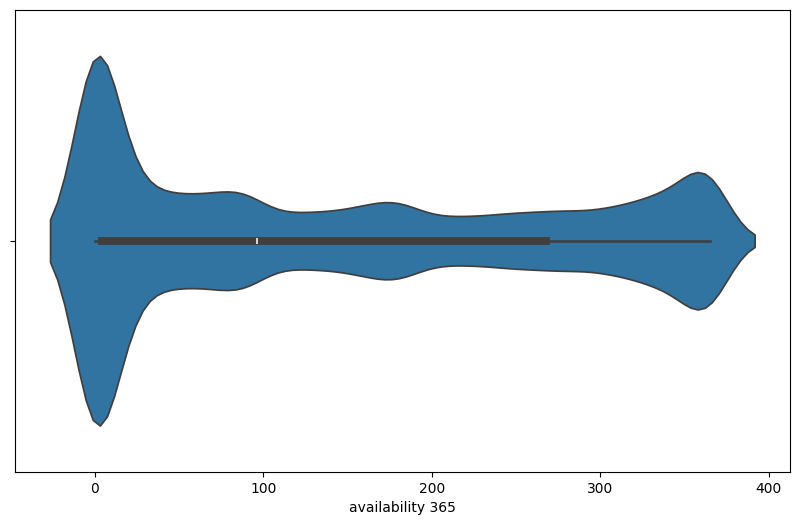

In [22]:
plt.figure(figsize=(10, 6))  # Imposta le dimensioni della figura
sns.violinplot(x=airbnb['availability 365'])
plt.show()

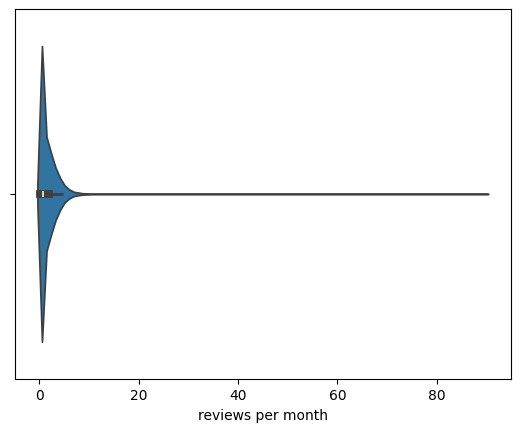

In [23]:
sns.violinplot(x=airbnb['reviews per month'])
plt.show()

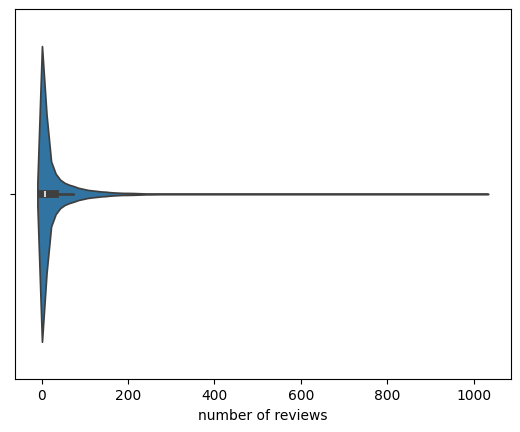

In [24]:
sns.violinplot(x=airbnb['number of reviews'])
plt.show()

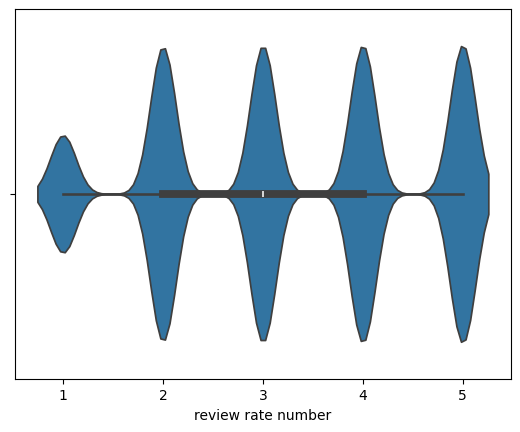

In [25]:
sns.violinplot(x=airbnb['review rate number'])
plt.show()

In [26]:
airbnb['number of reviews'].fillna(airbnb['number of reviews'].median(), inplace=True)
airbnb['reviews per month'].fillna(airbnb['reviews per month'].median(), inplace=True)
airbnb['availability 365'].fillna(airbnb['availability 365'].median(), inplace=True)
airbnb['review rate number'].fillna(airbnb['review rate number'].mean(), inplace=True)

#### Per evitare inconsistenza, se la cella number of reviews è 0, pongo anche reviews per month a 0

In [27]:
airbnb.loc[airbnb['number of reviews'] == 0, 'reviews per month'] = 0

L'unico elemento che rimane da verificare è 'last review'

In [28]:
airbnb['last review'].describe()

count                            85662
mean     2019-06-10 16:57:58.714014976
min                2012-07-11 00:00:00
25%                2018-10-27 00:00:00
50%                2019-06-13 00:00:00
75%                2019-07-05 00:00:00
max                2058-06-16 00:00:00
Name: last review, dtype: object

Poichè ci sono delle date errate, prima pongo le date posteriori al giorno attuale, poi sostituisco le celle vuote con la media

In [29]:
from datetime import datetime
today = datetime.now().date()
airbnb['last review'] = airbnb['last review'].apply(lambda x: today if pd.notna(x) and x.date() > today else x)
airbnb['last review'] = pd.to_datetime(airbnb['last review'])
mean_date = airbnb['last review'].mean().date()
airbnb['last review'].fillna(mean_date,inplace=True)
airbnb['last review'] = pd.to_datetime(airbnb['last review'])

C:\Users\franc\AppData\Local\Temp\ipykernel_23728\4098036614.py:6: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '2019-06-10' has dtype incompatible with datetime64[ns], please explicitly cast to a compatible dtype first.
  airbnb['last review'].fillna(mean_date,inplace=True)


In [30]:
airbnb.isnull().sum()

id                                0
host id                           0
host_identity_verified            0
neighbourhood group               0
neighbourhood                     0
lat                               0
long                              0
instant_bookable                  0
cancellation_policy               0
room type                         0
Construction year                 0
price                             0
service fee                       0
minimum nights                    0
number of reviews                 0
last review                       0
reviews per month                 0
review rate number                0
calculated host listings count    0
availability 365                  0
dtype: int64

## Visualizzazione delle feature

Divido le colonne in categoriche e numeriche

In [31]:
cat_columns = ['host_identity_verified','instant_bookable','room type','cancellation_policy','neighbourhood group','neighbourhood','Construction year']
num_columns = ['lat','long','minimum nights','number of reviews','reviews per month','price','service fee','calculated host listings count','availability 365','review rate number']

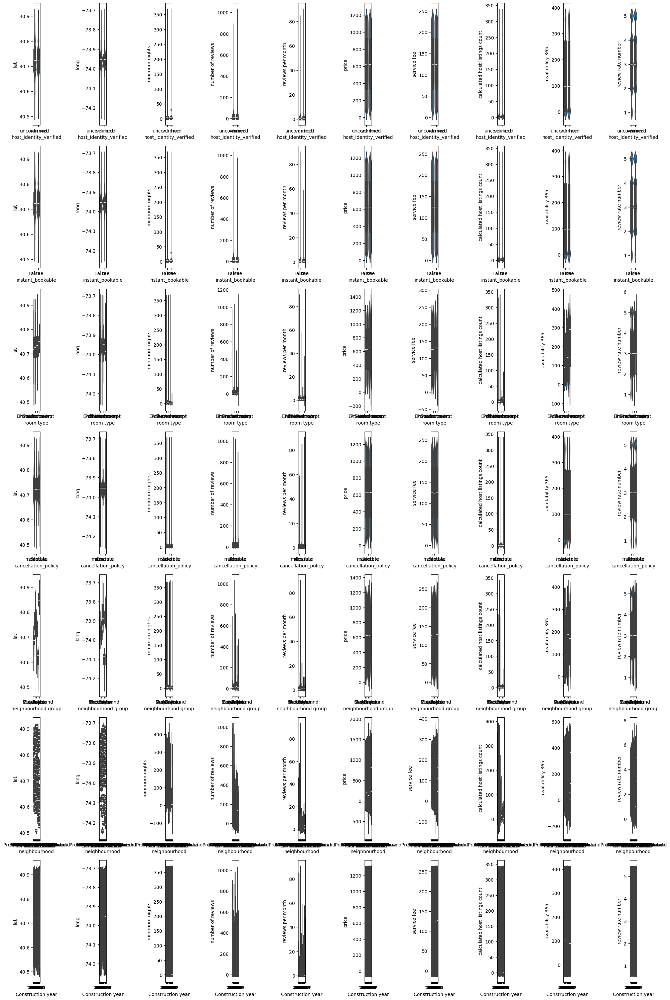

In [32]:
fig, axes = plt.subplots(len(cat_columns), len(num_columns), figsize=(20, 30))

for i, cat_column in enumerate(cat_columns):
    for j, num_column in enumerate(num_columns):
        sns.violinplot(x=cat_column, y=num_column, data=airbnb, ax=axes[i, j])

plt.tight_layout()
plt.show()

<Axes: xlabel='number of reviews', ylabel='reviews per month'>

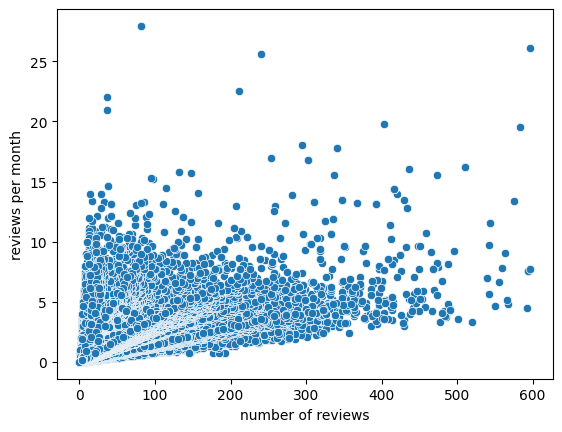

In [33]:
sns.scatterplot(x=airbnb[airbnb['number of reviews']<600]['number of reviews'],y=airbnb[airbnb['reviews per month']<40]['reviews per month'])

##### Voglio vedere i quartieri con più bnb

In [34]:
airbnb.neighbourhood.value_counts().head(10)

neighbourhood
Bedford-Stuyvesant    7846
Williamsburg          7682
Harlem                5407
Bushwick              4921
Hell's Kitchen        3935
Upper West Side       3824
Upper East Side       3634
East Village          3445
Midtown               3337
Crown Heights         3231
Name: count, dtype: int64

##### Per ogni neighbourhood group, verifico i tipi di stanza in ogni quartiere 

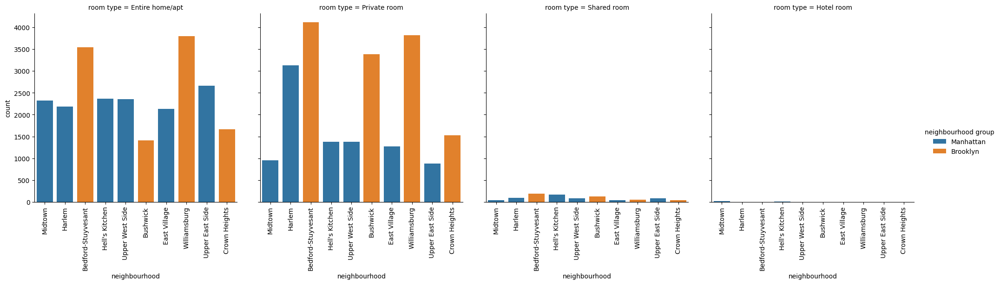

In [35]:
sub_7=airbnb.loc[airbnb['neighbourhood'].isin(['Bedford-Stuyvesant','Williamsburg','Harlem','Bushwick',
                 'Hell\'s Kitchen','Upper West Side','Upper East Side','East Village','Crown Heights','Midtown'])]

viz_3=sns.catplot(x='neighbourhood', hue='neighbourhood group', col='room type', data=sub_7, kind='count')
viz_3.set_xticklabels(rotation=90)

#### Vedo se c'è una correlazione tra il prezzo e il quartiere

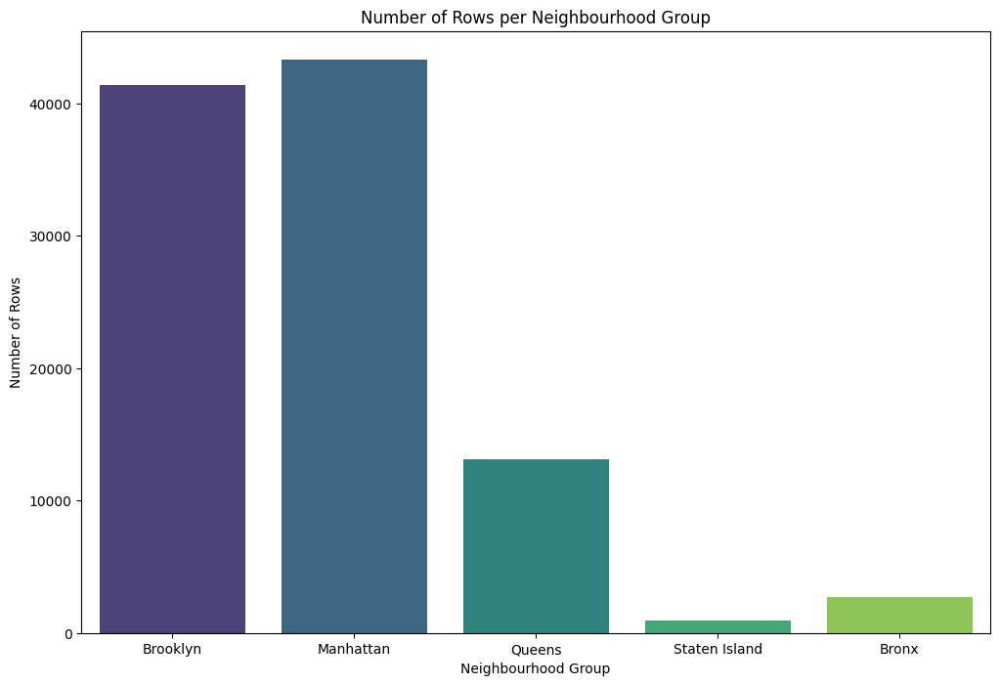

In [36]:
plt.figure(figsize=(12, 8))
sns.countplot(x='neighbourhood group', data=airbnb, hue='neighbourhood group', palette='viridis', legend=False)
plt.title('Number of Rows per Neighbourhood Group')
plt.xlabel('Neighbourhood Group')
plt.ylabel('Number of Rows')
plt.show()

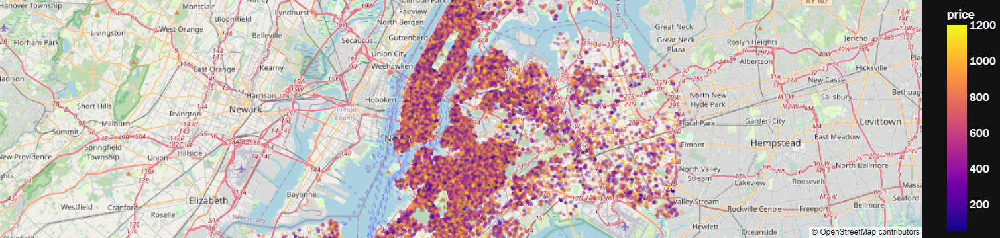

In [37]:
fig = px.scatter_mapbox(airbnb,lat="lat",
           lon="long",
           opacity = 0.3,
           hover_name="neighbourhood group",
           hover_data=["neighbourhood group", "price"],
           color="price",
           color_discrete_sequence=px.colors.sequential.PuBuGn,
           template = "plotly_dark",
           zoom=10
           )
fig.update_layout(mapbox_style="open-street-map")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0},font = dict(size=17,family="Franklin Gothic"))
fig.show()

##### Vedo la relazione tra il prezzo e l'anno di costruzione

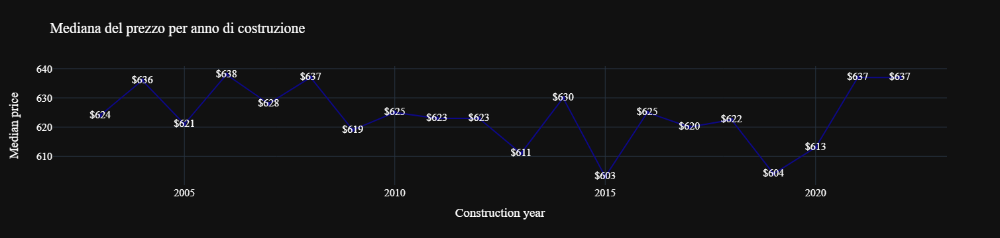

In [38]:
price_per_year = airbnb.groupby('Construction year')['price'].median()

fig = px.line(price_per_year,
              x=price_per_year.index,
              y=price_per_year.values,
              labels={'x': 'Construction year', 'y': 'Median price'},
              text=['$' + str(int(i)) for i in price_per_year.values],
              title='Mediana del prezzo per anno di costruzione',
              color_discrete_sequence=px.colors.sequential.Plasma,  # Cambiato il colore
              template='plotly_dark'
)

fig.update_layout(font=dict(size=16, color='white', family='Avenir'))

fig.show()

## Cerco una correlazione tra 'room type' e 'price'

#### Vedo la distribuzione dei room type

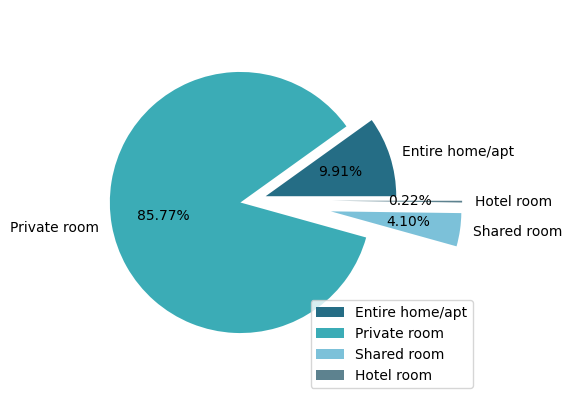

In [39]:
plt.figure(figsize=(5, 5))
data = [5269, 45606, 2182, 115]
labels = ["Entire home/apt", "Private room", "Shared room", "Hotel room"]
explode = [0.1, 0.1, 0.6, 0.6]
plt.pie(data, labels=labels, explode=explode, autopct="%1.2f%%", colors=['#256D85', '#3BACB6', '#7cc1d9', '#5d828f'])
plt.axis('equal')
plt.legend()
plt.show()

#### Vedo la correlazione tra price e room type

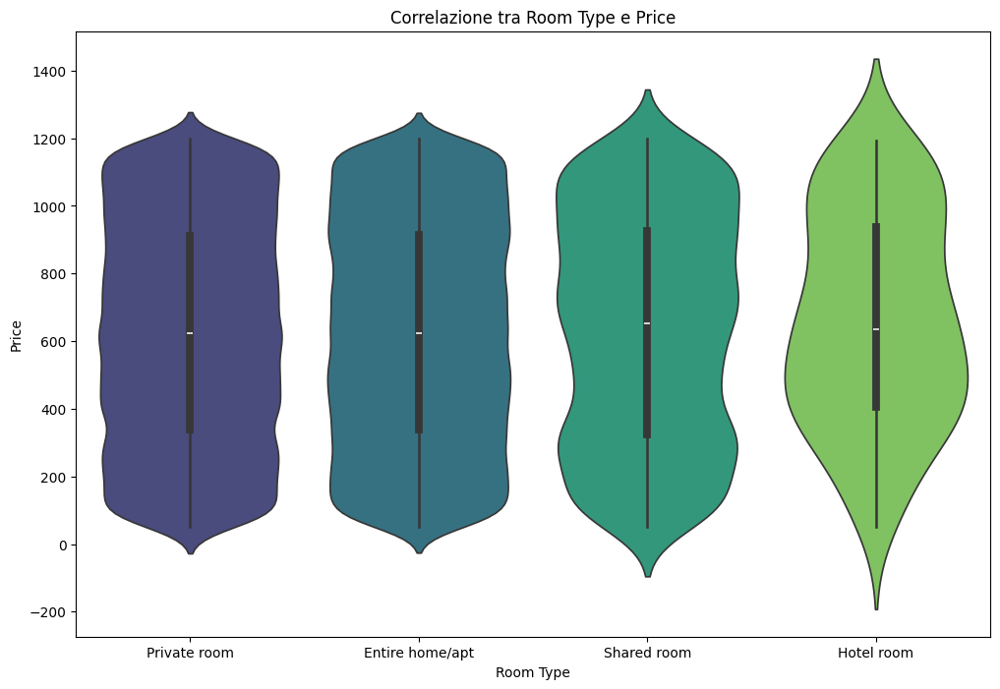

In [40]:
plt.figure(figsize=(12, 8))
sns.violinplot(x='room type', y='price', data=airbnb, palette='viridis', hue='room type', legend=False)
plt.title('Correlazione tra Room Type e Price')
plt.xlabel('Room Type')
plt.ylabel('Price')
plt.show()

#### Vedo la correlazione tra price e room type in base al quartiere

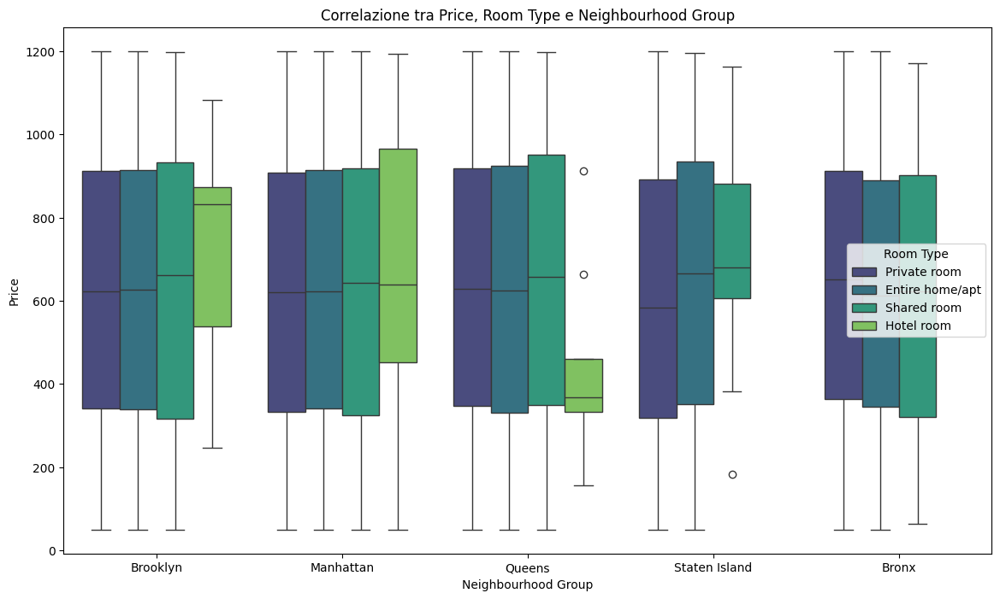

In [41]:
plt.figure(figsize=(14, 8))
sns.boxplot(x='neighbourhood group', y='price', hue='room type', data=airbnb, palette='viridis')
plt.title('Correlazione tra Price, Room Type e Neighbourhood Group')
plt.xlabel('Neighbourhood Group')
plt.ylabel('Price')
plt.legend(title='Room Type')
plt.show()

##### Voglio mostrare il count delle varie fasce di prezzo

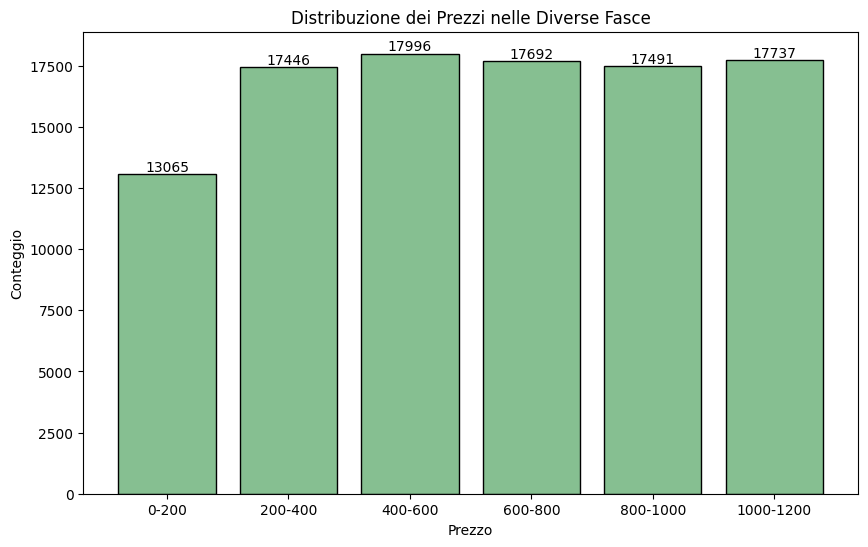

In [42]:
prices = airbnb['price']

bins = [0, 200, 400, 600, 800, 1000, 1200]

plt.figure(figsize=(10, 6))
n, _, _ = plt.hist(prices, bins=bins, color='#86bf91', edgecolor='black', rwidth=0.8)  # Puoi regolare la larghezza relativa a tuo piacimento

plt.xlabel('Prezzo')
plt.ylabel('Conteggio')
plt.title('Distribuzione dei Prezzi nelle Diverse Fasce')

bin_centers = 0.5 * (pd.Series(bins[:-1]).map(float) + pd.Series(bins[1:]).map(float))
plt.xticks(bin_centers, [f'{bins[i]}-{bins[i+1]}' for i in range(len(bins)-1)])

for count, x in zip(n, bin_centers):
    plt.text(x, count, str(int(count)), ha='center', va='bottom')

plt.show()

##### Mostro la correlazione tra price e le variabili mancanti

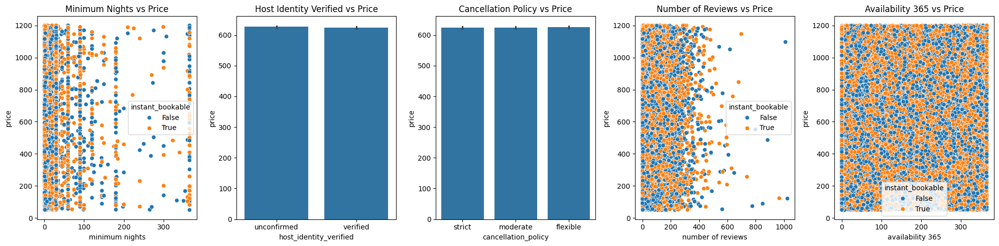

In [43]:
fig, axs = plt.subplots(1, 5, figsize=(20, 5))

# Scatter plot per 'minimum_nights' e 'price'
sns.scatterplot(x='minimum nights', y='price', data=airbnb, hue='instant_bookable', ax=axs[0])
axs[0].set_title('Minimum Nights vs Price')

# Bar plot per 'host_identity_verified' e 'price'
sns.barplot(x='host_identity_verified', y='price', data=airbnb, ax=axs[1])
axs[1].set_title('Host Identity Verified vs Price')

# Bar plot per 'cancellation_policy' e 'price'
sns.barplot(x='cancellation_policy', y='price', data=airbnb, ax=axs[2])
axs[2].set_title('Cancellation Policy vs Price')

# Scatter plot per 'number_of_reviews' e 'price'
sns.scatterplot(x='number of reviews', y='price', data=airbnb, hue='instant_bookable', ax=axs[3])
axs[3].set_title('Number of Reviews vs Price')

# Scatter plot per 'availability_365' e 'price'
sns.scatterplot(x='availability 365', y='price', data=airbnb, hue='instant_bookable', ax=axs[4])
axs[4].set_title('Availability 365 vs Price')

plt.tight_layout()
plt.show()


#### Heathmap 

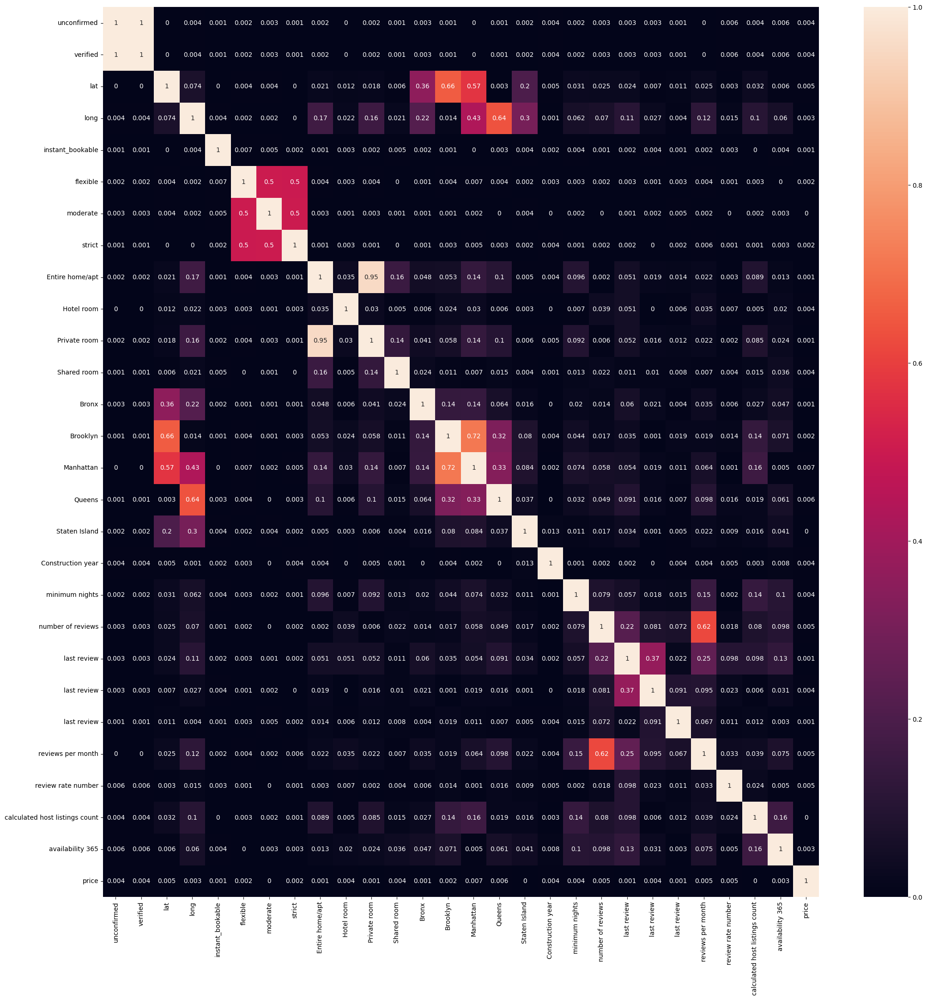

In [59]:
top_neighbourhoods = airbnb['neighbourhood'].value_counts().nlargest(10).index

df = pd.concat([
    pd.get_dummies(airbnb.host_identity_verified).astype(int), 
    airbnb.lat, 
    airbnb.long, 
    airbnb.instant_bookable.astype(int), 
    pd.get_dummies(airbnb.cancellation_policy).astype(int), 
    pd.get_dummies(airbnb['room type']).astype(int), 
    pd.get_dummies(airbnb['neighbourhood group']).astype(int),
    #pd.get_dummies(airbnb['neighbourhood'][airbnb['neighbourhood'].isin(top_neighbourhoods)]).astype(int),
    airbnb['Construction year'],
    airbnb['minimum nights'],
    airbnb['number of reviews'],
    airbnb['last review'].dt.strftime('%Y').astype(int),
    airbnb['last review'].dt.strftime('%m').astype(int),
    airbnb['last review'].dt.strftime('%d').astype(int),
    airbnb['reviews per month'],
    airbnb['review rate number'],    
    airbnb['calculated host listings count'],
    airbnb['availability 365'],
    airbnb.price
], axis = 1)

import matplotlib.pyplot as plt

sns.heatmap(df.corr().apply(lambda x: round(x.abs(), 3)), annot = True)

plt.rcParams["figure.figsize"] = (25,25)

plt.show()

### Ricerca del modello di predizione più adatto

#### Train-Test split

In [45]:
from sklearn.model_selection import train_test_split
Y = df['price']
###v1 = df.drop('price', axis=1)
###v2  columns_to_drop = ['price', 'unconfirmed', 'verified', 'lat', 'long', 'last review', 'availability 365', 'flexible', 'moderate', 'strict']
columns_to_drop = ['price', 'unconfirmed', 'verified', 'lat', 'long', 'last review', 'availability 365', 'flexible', 'moderate', 'strict','instant_bookable','review rate number','calculated host listings count','reviews per month','Construction year','minimum nights']
X = df.drop(columns=columns_to_drop, axis=1)
np.random.seed(0)
X_train, X_test, Y_train, Y_test = train_test_split(X,Y,test_size = 0.1, random_state = 100)
print(X.columns)

Index(['Entire home/apt', 'Hotel room', 'Private room', 'Shared room', 'Bronx',
       'Brooklyn', 'Manhattan', 'Queens', 'Staten Island',
       'number of reviews'],
      dtype='object')


#### Standardizzo i valori numerici

In [46]:
from sklearn.preprocessing import RobustScaler

rs = RobustScaler()
X_train = rs.fit_transform(X_train)
X_test = rs.transform(X_test)

#### Applico la K-Fold-Cross-Validation

In [47]:
from sklearn.model_selection import KFold
### v1 kfold = KFold(n_splits=5, shuffle=True, random_state=42)
kfold = KFold(n_splits=10, shuffle=True, random_state=42)

#### Funzione per testare i modelli:

In [48]:
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import r2_score, mean_squared_log_error, mean_absolute_error,mean_squared_error
import time

def tryModello(model, parameters, X_train, Y_train, X_test, Y_test, cv):
    mod = GridSearchCV(model, parameters, cv=cv, refit=True)
    mod.fit(X_train, Y_train)

    mod = mod.best_estimator_
    
    start_time = time.time()
    
    Y_pred_test = mod.predict(X_test)
    Y_pred_train = mod.predict(X_train)


    elapsed_time = time.time() - start_time
    print(f"\nTime elapsed: {round(elapsed_time, 3)} seconds")
    print("\nTrain metrics: ")
    print("Mean Squared log error train: ", round(mean_squared_log_error(Y_train, Y_pred_train), 4))
    print("Root Mean Squared Error train: ", round(np.sqrt(mean_squared_error(Y_train, Y_pred_train)), 4))
    print("Mean Absolute Error train: ", round(mean_absolute_error(Y_train, Y_pred_train), 4))
    print("R2 score pred train: ", round(r2_score(Y_train, Y_pred_train), 4))
    print("\nTest Metrics: ")
    print("Mean Squared log Error test: ", round(mean_squared_log_error(Y_test, Y_pred_test), 4))
    print("Root Mean Squared Error test: ", round(np.sqrt(mean_squared_error(Y_test, Y_pred_test)), 4))
    print("Mean Absolute Error test: ", round(mean_absolute_error(Y_test, Y_pred_test), 4))
    print("R2 score pred test: ", round(r2_score(Y_test, Y_pred_test), 4))

    # Differenza tra le metriche di allenamento e test per rilevare underfitting o overfitting
    train_test_difference = {
        "RMSE": np.sqrt(mean_squared_error(Y_train, Y_pred_train)) - np.sqrt(mean_squared_error(Y_test, Y_pred_test)),
        "MAE": mean_absolute_error(Y_train, Y_pred_train) - mean_absolute_error(Y_test, Y_pred_test),
        "R2": r2_score(Y_train, Y_pred_train) - r2_score(Y_test, Y_pred_test)
    }
    print("\nDifferenza tra metriche di Train e Test:")
    for metric, difference in train_test_difference.items():
        print(f"{metric}: {round(difference, 4)}")

    # Visualizzo il grafico
    fig = plt.figure(figsize=(8, 6))
    plt.scatter(Y_test, Y_pred_test)
    fig.suptitle('Y test vs Y predicted', fontsize=20)
    plt.xlabel('Y test', fontsize=18)
    plt.ylabel('Y predicted', fontsize=16)
    plt.show()


#### Predittore randomico

In [49]:
# Genero n valori casuali con distribuzione normale nel range (50-1200)
mean_value = (1200 + 50) / 2
std_dev = (1200 - 50) / (2 * 3.29)  # Utilizzando 3.29 come fattore di scala
n = len(df)
y_rand = np.random.normal(loc=mean_value, scale=std_dev, size=n)

y_true = df['price']
rmse_random = np.sqrt(mean_squared_error(y_true, y_rand))
r2_random = r2_score(y_true, y_rand)

y_pred_random = np.random.normal(loc=mean_value, scale=std_dev, size=n)
rmse_pred_random = np.sqrt(mean_squared_error(y_true, y_pred_random))
r2_pred_random = r2_score(y_true, y_pred_random)

print(f"RMSE tra 'price' e valori casuali generati: {rmse_random}")
print(f"R2 tra 'price' e valori casuali generati: {r2_random}")

print(f"\nRMSE tra 'price' e predittore randomico: {rmse_pred_random}")
print(f"R2 tra 'price' e predittore randomico: {r2_pred_random}")

RMSE tra 'price' e valori casuali generati: 374.4893440380752
R2 tra 'price' e valori casuali generati: -0.2747834183804203

RMSE tra 'price' e predittore randomico: 375.12022759447046
R2 tra 'price' e predittore randomico: -0.2790821646112325


#### Testo la regressione lineare


Time elapsed: 0.004 seconds

Train metrics: 
Mean Squared log error train:  0.5817
Root Mean Squared Error train:  331.7164
Mean Absolute Error train:  286.8617
R2 score pred train:  0.0001

Test Metrics: 
Mean Squared log Error test:  0.5618
Root Mean Squared Error test:  331.2133
Mean Absolute Error test:  286.7976
R2 score pred test:  -0.0002

Difference between Train and Test metrics:
RMSE: 0.5031
MAE: 0.0641
R2: 0.0004


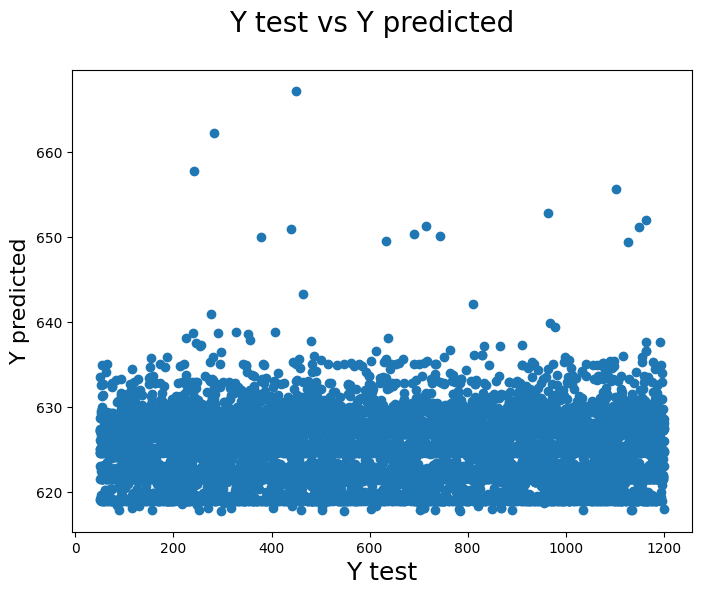

In [50]:
from sklearn.linear_model import LinearRegression
parameters = {'fit_intercept': [True, False], 'copy_X': [True, False]}
tryModello(LinearRegression(), parameters, X_train, Y_train, X_test, Y_test, cv=kfold)

#### Testo il modello Lasso


Time elapsed: 0.004 seconds

Train metrics: 
Mean Squared log error train:  0.5817
Root Mean Squared Error train:  331.7206
Mean Absolute Error train:  286.8677
R2 score pred train:  0.0001

Test Metrics: 
Mean Squared log Error test:  0.5618
Root Mean Squared Error test:  331.2175
Mean Absolute Error test:  286.8034
R2 score pred test:  -0.0003

Difference between Train and Test metrics:
RMSE: 0.5031
MAE: 0.0643
R2: 0.0004


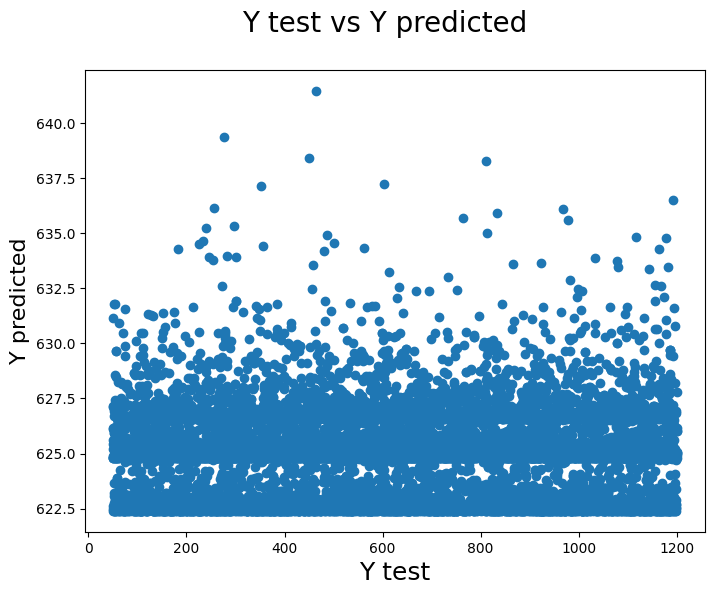

In [51]:
from sklearn.linear_model import Lasso
parameters = {
    'alpha': [0.1, 0.5, 1.0, 2.0, 5.0],
    'fit_intercept': [True, False],
    'max_iter': [1000, 2000, 5000]
}

tryModello(Lasso(), parameters, X_train, Y_train, X_test, Y_test, cv=kfold)

#### Testo il modello Ridge


Time elapsed: 0.004 seconds

Train metrics: 
Mean Squared log error train:  0.5817
Root Mean Squared Error train:  331.7137
Mean Absolute Error train:  286.8572
R2 score pred train:  0.0001

Test Metrics: 
Mean Squared log Error test:  0.5618
Root Mean Squared Error test:  331.2319
Mean Absolute Error test:  286.8033
R2 score pred test:  -0.0004

Difference between Train and Test metrics:
RMSE: 0.4818
MAE: 0.054
R2: 0.0005


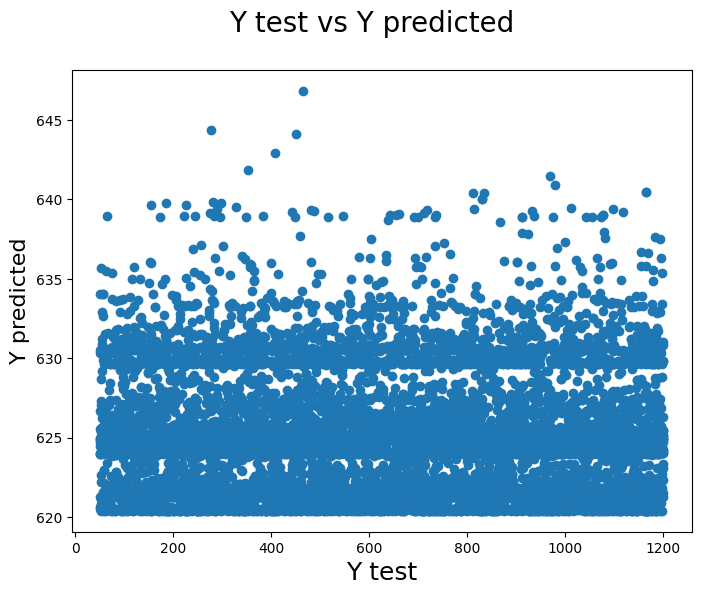

In [52]:
from sklearn.linear_model import Ridge
parameters = {
    'alpha': [0.1, 0.5, 1.0, 2.0, 5.0],
    'fit_intercept': [True, False],
    'solver': ['auto', 'svd', 'cholesky', 'lsqr', 'sparse_cg', 'sag', 'saga']
}

tryModello(Ridge(), parameters, X_train, Y_train, X_test, Y_test, cv=kfold)

#### Testo la regressione con Random Forest v1


Time elapsed: 1.024 seconds

Train metrics: 
Mean Squared log error train:  0.5721
Root Mean Squared Error train:  327.8976
Mean Absolute Error train:  282.9871
R2 score pred train:  0.023

Test Metrics: 
Mean Squared log Error test:  0.5595
Root Mean Squared Error test:  330.2699
Mean Absolute Error test:  285.385
R2 score pred test:  0.0054

Difference between Train and Test metrics:
RMSE: -2.3723
MAE: -2.398
R2: 0.0176


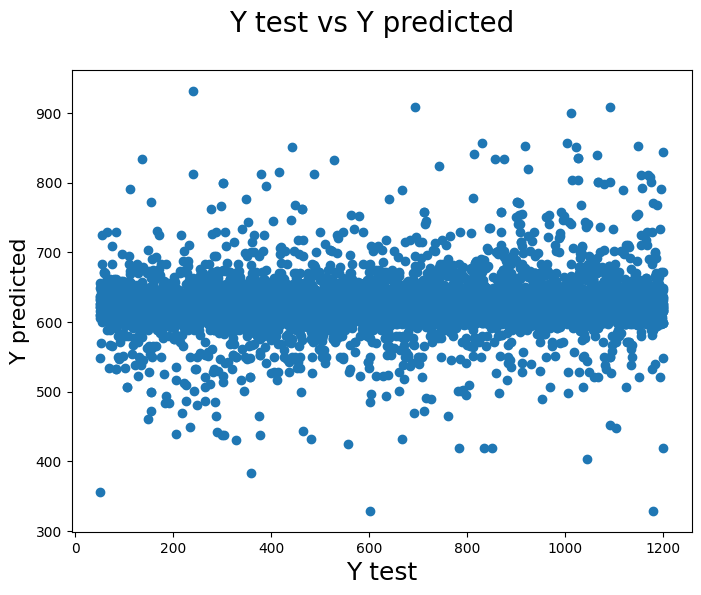

In [53]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import RandomizedSearchCV

param_dist = {
    'n_estimators': [int(x) for x in np.linspace(start=10, stop=200, num=10)],
    'max_features': [1, 2, 4, 6, 8, 10],
    'max_depth': [int(x) for x in np.linspace(1, 20, num=10)],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'bootstrap': [True]  
}

random_search = RandomizedSearchCV(
    RandomForestRegressor(random_state=0, oob_score=True), param_distributions=param_dist, n_iter=10, cv=kfold, scoring='neg_mean_squared_error', random_state=0, n_jobs=-1
)
random_search.fit(X_train, Y_train)

tryModello(random_search.best_estimator_, {}, X_train, Y_train, X_test, Y_test, cv=kfold)

#### Testo la regressione con Random Forest v2


Time elapsed: 1.927 seconds

Train metrics: 
Mean Squared log error train:  0.5711
Root Mean Squared Error train:  327.4778
Mean Absolute Error train:  282.5946
R2 score pred train:  0.0255

Test Metrics: 
Mean Squared log Error test:  0.5596
Root Mean Squared Error test:  330.2774
Mean Absolute Error test:  285.242
R2 score pred test:  0.0054

Difference between Train and Test metrics:
RMSE: -2.7996
MAE: -2.6473
R2: 0.0201


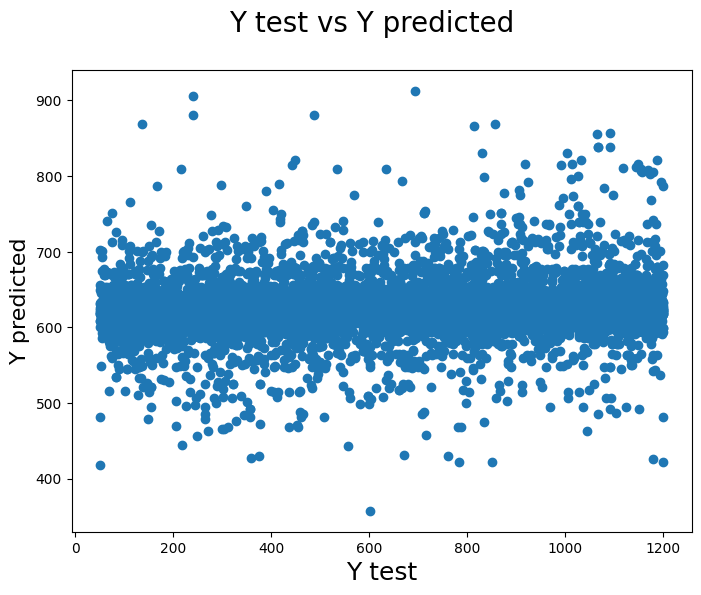

In [54]:
param_dist = {
    'n_estimators': [int(x) for x in np.linspace(start=50, stop=200, num=10)],
    'max_features': [1, 2, 4, 6, 8, 10, 'sqrt', 'log2'],
    'max_depth': [int(x) for x in np.linspace(5, 30, num=10)],
    'min_samples_split': [5, 10, 15],
    'min_samples_leaf': [2, 4, 6],
    'bootstrap': [True]  
}

random_search = RandomizedSearchCV(
    RandomForestRegressor(random_state=0, oob_score=True, bootstrap=True), param_distributions=param_dist, n_iter=10, cv=kfold, random_state=0, n_jobs=-1
)
random_search.fit(X_train, Y_train)

tryModello(random_search.best_estimator_, {}, X_train, Y_train, X_test, Y_test, cv=kfold)

#### Testo la regressione con Xgboost v1


Time elapsed: 0.023 seconds

Train metrics: 
Mean Squared log error train:  0.5763
Root Mean Squared Error train:  329.584
Mean Absolute Error train:  284.6489
R2 score pred train:  0.0129

Test Metrics: 
Mean Squared log Error test:  0.5605
Root Mean Squared Error test:  330.7336
Mean Absolute Error test:  285.9077
R2 score pred test:  0.0026

Difference between Train and Test metrics:
RMSE: -1.1496
MAE: -1.2588
R2: 0.0103


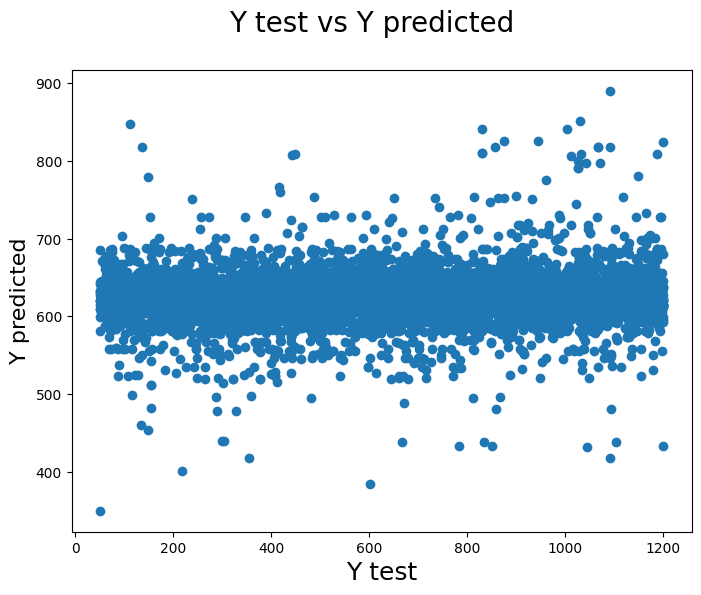

In [55]:
import xgboost as xgb

xgb_model = xgb.XGBRegressor()
parameters = {
    'n_estimators': [100, 200, 300],
    'learning_rate': [0.01, 0.1, 0.2],
    'max_depth': [3, 4, 5]
}
tryModello(xgb_model, parameters, X_train, Y_train, X_test, Y_test, cv=kfold)

#### Testo la regressione con Xgboost v2


Time elapsed: 0.023 seconds

Train metrics: 
Mean Squared log error train:  0.5781
Root Mean Squared Error train:  330.2525
Mean Absolute Error train:  285.4213
R2 score pred train:  0.0089

Test Metrics: 
Mean Squared log Error test:  0.561
Root Mean Squared Error test:  330.8662
Mean Absolute Error test:  286.2581
R2 score pred test:  0.0018

Difference between Train and Test metrics:
RMSE: -0.6137
MAE: -0.8368
R2: 0.0071


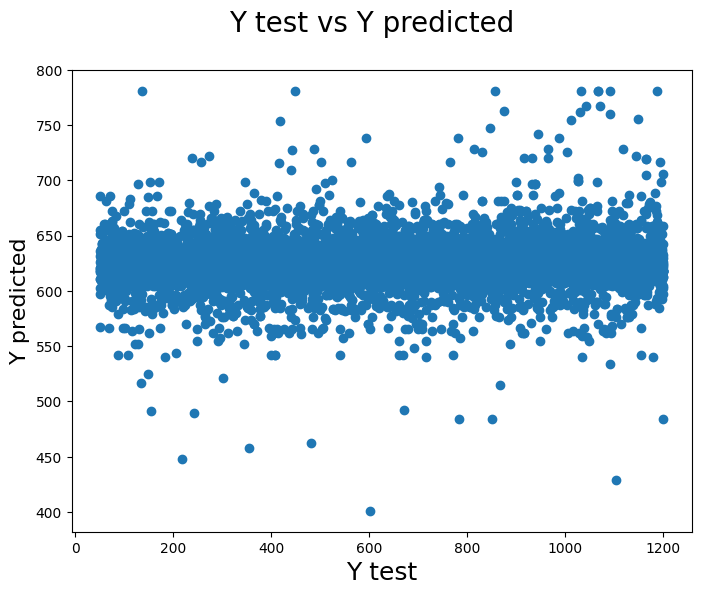

In [56]:
import xgboost as xgb

xgb_model = xgb.XGBRegressor()
parameters = {
    'n_estimators': [100, 200, 300],
    'learning_rate': [0.01, 0.1, 1],
    'max_depth': [3, 4, 5]
}
tryModello(xgb_model, parameters, X_train, Y_train, X_test, Y_test, cv=kfold)

#### Testo elasticnet


Time elapsed: 0.002 seconds

Train metrics: 
Mean Squared log error train:  0.5817
Root Mean Squared Error train:  331.7224
Mean Absolute Error train:  286.8689
R2 score pred train:  0.0001

Test Metrics: 
Mean Squared log Error test:  0.5618
Root Mean Squared Error test:  331.2139
Mean Absolute Error test:  286.7997
R2 score pred test:  -0.0003

Difference between Train and Test metrics:
RMSE: 0.5085
MAE: 0.0693
R2: 0.0003


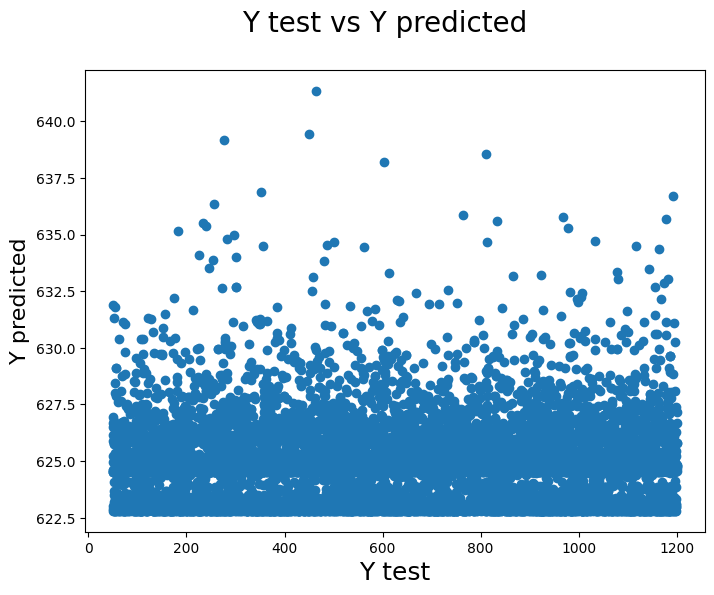

In [57]:
from sklearn.linear_model import ElasticNet
elasticnet_model = ElasticNet()
parameters = {
    'alpha': [0.1, 0.5, 1.0],
    'l1_ratio': [0.1, 0.5, 0.9],
    'max_iter': [1000, 2000, 3000]
}
tryModello(elasticnet_model, parameters, X_train, Y_train, X_test, Y_test, cv=kfold)

#### Testo con regressione polinomiale di grado 2


Time elapsed: 0.012 seconds

Train metrics: 
Mean Squared log error train:  0.5816
Root Mean Squared Error train:  331.6899
Mean Absolute Error train:  286.8197
R2 score pred train:  0.0003

Test Metrics: 
Mean Squared log Error test:  0.5616
Root Mean Squared Error test:  331.1722
Mean Absolute Error test:  286.765
R2 score pred test:  0.0

Difference between Train and Test metrics:
RMSE: 0.5177
MAE: 0.0547
R2: 0.0003


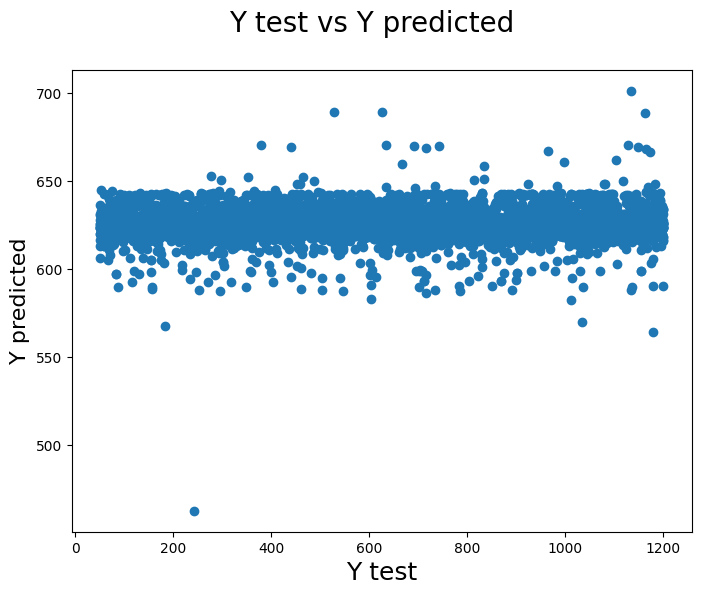

In [58]:
from sklearn.preprocessing import PolynomialFeatures
from sklearn.pipeline import make_pipeline
parameters = {'fit_intercept': [True, False], 'copy_X': [True, False]}
polyfeats = PolynomialFeatures(degree=2)
X_train_poly = polyfeats.fit_transform(X_train)
X_test_poly = polyfeats.transform(X_test)

tryModello(LinearRegression(), parameters, X_train_poly, Y_train, X_test_poly, Y_test, cv=kfold)